
**The goal of the project is to classify 20 different types of caps/headwears worn around the world.**

# Setting up necessary things

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
bs=32
version=2

In [ ]:
!pip install -Uqq fastai fastbook nbdev

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.1/67.1 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.8/547.8 kB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 53.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 16.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 65.4 MB/s eta 0:00:00
ERROR: pip's dependency r

In [2]:
from fastai import *
from fastai.vision.all import *
from fastai.vision.widgets import *
import os

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%cd /content/drive/My Drive/Mastercourse/Jersey Recogniser

/content/drive/My Drive/Mastercourse/Jersey Recogniser


In [9]:
jersey_labels=[
    'Manchester United Jersey',
    'Chelsea Jersey',
    'Real Madrid Jersey',
    'Arsenal Jersey',
    'Newcastle Jersey',
    'Liverpool Jersey',
    'Juventus Jersey',
    'AC Milan Jersey',
    'Inter Milan Jersey',
    'Barcelona Jersey',
    'Tottenham Jersey',
    'Bayern Munich Jersey',
    'Atletico Madrid Jersey',
    'Southampton Jersey',
    'Leeds United Jersey',
    'Manchester City Jersey',
    'Napoly Jersey',
    'FC Porto Jersey',
    'PSG Jersey',
    'Borussia Dortmund Jersey'
]
len(jersey_labels)

20

# Fetch Data

In [5]:
data_path='data'
dblock=DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,                       #get_image_files returns a list of all images in that path recursively by default
    splitter=RandomSplitter(valid_pct=0.1,seed=42),  #getting 90-10 train validation split
    get_y=parent_label,                              #taking the folder name as labels
    item_tfms=Resize(128))                           #resizing to get the image of same shape

In [6]:
dblock=dblock.new(item_tfms=RandomResizedCrop(224,min_scale=0.5),batch_tfms=aug_transforms())
dls=dblock.dataloaders(data_path,bs=bs)
torch.save(dls,f"jersey_dataloader_v{version}.pk1")

In [7]:
dls=torch.load(f"jersey_dataloader_v{version}.pk1")

In [8]:
dls.train.vocab

['AC Milan Jersey', 'Arsenal Jersey', 'Atletico Madrid Jersey', 'Barcelona Jersey', 'Bayern Munich Jersey', 'Borussia Dortmund Jersey', 'Chelsea Jersey', 'FC Porto Jersey', 'Inter Milan Jersey', 'Juventus Jersey', 'Leeds United Jersey', 'Liverpool Jersey', 'Manchester City Jersey', 'Manchester United Jersey', 'Napoly Jersey', 'Newcastle Jersey', 'PSG Jersey', 'Real Madrid Jersey', 'Southampton Jersey', 'Tottenham Jersey']

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


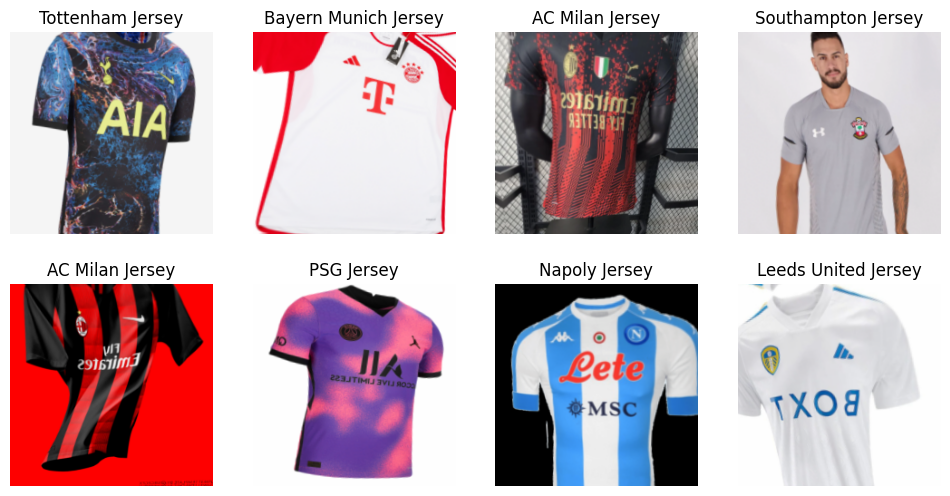

In [ ]:
dls.train.show_batch(max_n=8,nrows=2)

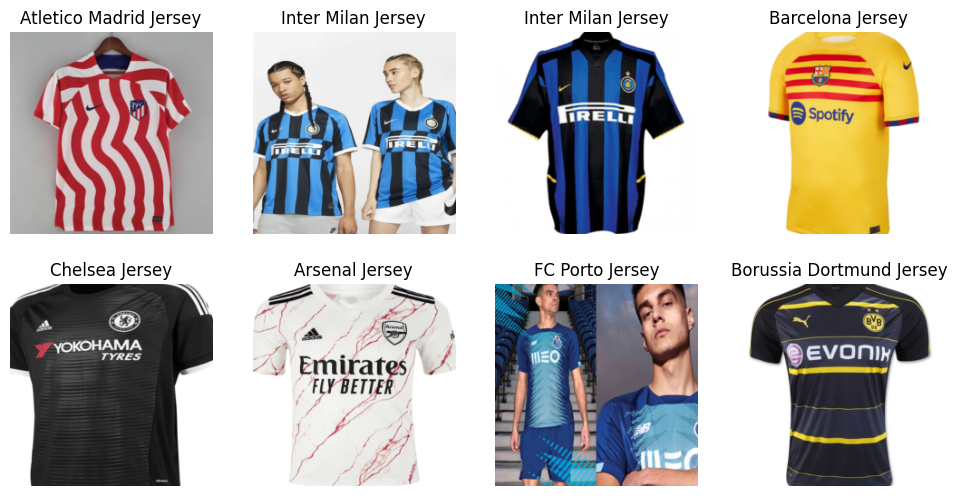

In [ ]:
dls.valid.show_batch(max_n=8,nrows=2)

# Training and Data Cleaning

In [ ]:
model_path='models'

In [ ]:
model=vision_learner(dls,resnet34,metrics=[error_rate,accuracy],path='checkpoints')
cbs=[SaveModelCallback(every_epoch=True)]

In [ ]:
model.load(f"jersey_recognizer-v{version-2}")

In [ ]:
model.fine_tune(2)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.280468,0.111642,0.052023,0.947977,22:24


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.367494,0.204077,0.052023,0.947977,32:37
1,0.265942,0.129987,0.049133,0.950867,32:22


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes sh

In [ ]:
# For loading a model
#model=vision_learner(dls,resnet34,metrics=[error_rate,accuracy],path='checkpoints')
#model.load('model')
#model.fine_tune(4)


In [ ]:
model.save(f"jersey_recognizer-v{version}")

Path('checkpoints/models/jersey_recognizer-v2.pth')

In [ ]:
#model.load(f"jersey_recognizer-v{version}")

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


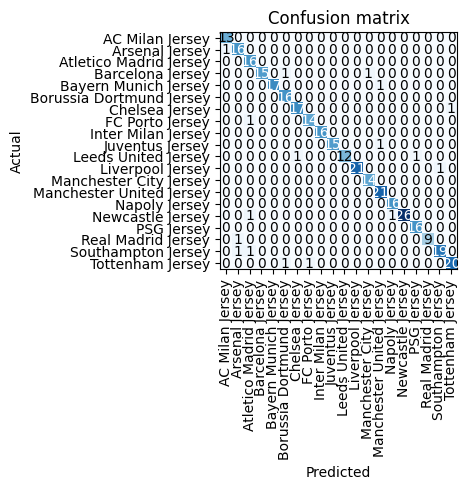

In [ ]:
interp=ClassificationInterpretation.from_learner(model)
interp.plot_confusion_matrix()

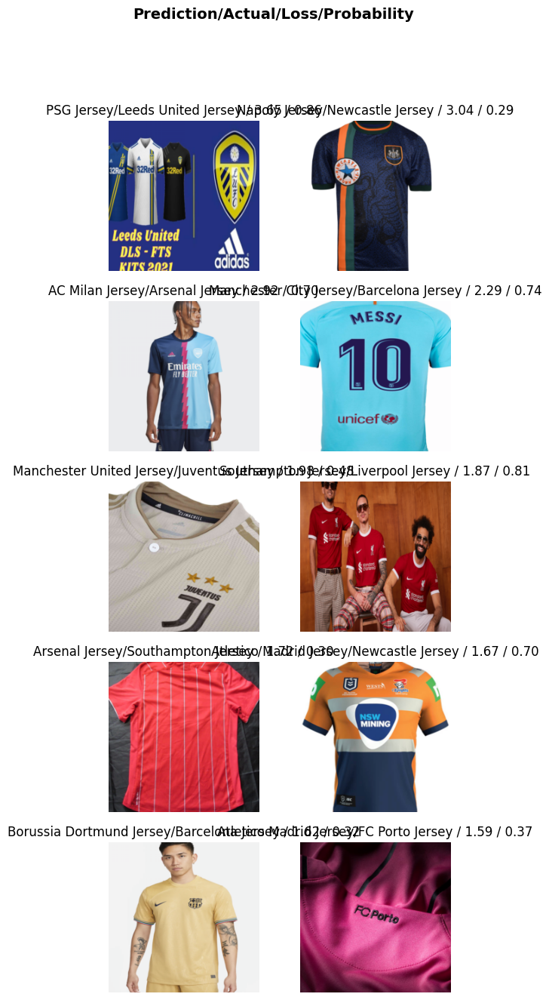

In [ ]:
interp.plot_top_losses(10,nrows=5)

In [ ]:
cleaner=ImageClassifierCleaner(model)

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
cleaner

In [ ]:
cleaner.delete()

(#1) [15]

In [ ]:
cleaner.change()

(#3) [(1, 'AC Milan Jersey'),(3, 'AC Milan Jersey'),(22, 'AC Milan Jersey')]

In [ ]:
for idx in cleaner.delete():cleaner.fns[idx].unlink()                                   #delete irrelevant data
for idx,cat in cleaner.change():shutil.move(str(cleaner.fns[idx]),f"{data_path}/{cat}") #Change the directory

# Export model for inference

In [ ]:
model.export(f"{model_path}/jersey-recogniser-v{version}.pkl")